##### Copyright 2018 The TensorFlow Authors.

# Neural style transfer

### Import and configure modules

In [9]:
import os
import tensorflow as tf
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools
from math import ceil, floor

from datetime import datetime
import tensorflow_hub as hub

time_str = datetime.now().strftime("%Y_%m_%d_%H_")
output_name = os.getcwd() + "/output_images/" + time_str
global img_num
img_num = 0
print(output_name)

hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

# simple function to load image
def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

# simple function to display image
def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)

def save_images(images):
    global img_num
    for i in range(len(images)):
        tf.keras.utils.save_img(output_name + str(img_num) + ".png", images[i])
        img_num = img_num + 1

def save_image(image):
    global img_num
    tf.keras.utils.save_img(output_name + str(img_num) + ".png", np.squeeze(image, 0))
    img_num = img_num + 1

def plot_images(images):
    print("images length: ", len(images))
    if len(images) > 1:
        nrows, hop_size = adjustGrid(len(images))
        plt.figure(figsize=(hop_size*10, nrows*10))
        plt.margins(0.0)
        # for each lines of the plo%
        print("plotting {} total images with {} columns in {} rows".format(len(images), hop_size, nrows))
        for i in range(len(images)):
            ax = plt.subplot(nrows, hop_size, i+1)
            plt.imshow(images[i])
            plt.axis("off")
            plt.savefig(output_name + str(img_num) + "_figure.png")
    else:
      plot_image(image)

def plot_image(image):
    image = np.squeeze(image, 0)
    plt.figure(figsize=(20, 20))
    plt.margins(0.0)
    plt.imshow(image)
    plt.axis("off")
    plt.savefig(output_name + str(img_num) + "_figure.png")

def singleImage(source, style):
    output_images = []
    source_image = load_img(source)
    style_image = load_img(style)
    output_images.extend(hub_model(tf.constant(source_image), tf.constant(style_image))[0])
    save_images(output_images)
    output_images.extend(style_image)
    output_images.extend(source_image)
    output_images.reverse()
    plot_images(output_images)

def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)


def adjustGrid(num, cmax=5):
    # find place where we "flip", use that to determine number of rows and columns
    # go from 1 to half of number
    rnum = 1
    cnum = num
    for rn in range(1, ceil(num/2) +1):
        rnum = rn
        cnum = ceil(num/rnum)
        # if the number of columns is no longer greater than the number of rows, undo the change and export numbers
        if cnum <= rnum and cnum <= cmax:
            break
    total = rnum * cnum
    # if total < num:
    # rnum = rnum + 1
    return (rnum, cnum)

    # for a given source file, apply all style images
def transferAllStyles(source_path, style_paths):
    '''applies style from all images in style path list to source path'''
    outputs = []
    source_image = load_img(source_path)
    print("source path: ", source_path)
    print("transfering {} styles: ".format(len(style_paths)))
    for i in range(len(style_paths)):
        print('.', end=' ')
        style_image = load_img(style_paths[i])
        outputs.extend(hub_model(tf.constant(source_image), tf.constant(style_image))[0])
    print(" DONE")
    save_images(outputs)
    plot_images(outputs)

def transferEverything():
     for i in range(len(source_img_paths)):
        transferAllStyles(source_img_paths[i], style_img_paths)

/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/output_images/2023_02_18_21_


In [ ]:
photo_style_img_paths = os.listdir(os.getcwd() + "/style_images/photos/")
photo_style_img_paths = [os.getcwd() + "/style_images/photos/" + x for x in photo_style_img_paths if x.lower().endswith(".jpg") or x.lower().endswith('.png')]
painting_style_img_paths = os.listdir(os.getcwd() + "/style_images/paintings/")
painting_style_img_paths = [os.getcwd() + "/style_images/paintings/" + x for x in painting_style_img_paths if x.lower().endswith(".jpg") or x.lower().endswith('.png')]
texture_style_img_paths = os.listdir(os.getcwd() + "/style_images/textures/")
texture_style_img_paths = [os.getcwd() + "/style_images/textures/" + x for x in texture_style_img_paths if x.lower().endswith(".jpg") or x.lower().endswith('.png')]

source_img_paths = os.listdir(os.getcwd() + "/source_images/")

style_img_paths = texture_style_img_paths
style_img_paths.extend(painting_style_img_paths)
style_img_paths.extend(photo_style_img_paths)

# list comprehension to ensure we get rid of .dstore files
source_img_paths = [os.getcwd() + "/source_images/" + x for x in source_img_paths if x.lower().endswith('.jpg') or x.lower().endswith('.png')]

print("{} source image paths : ".format(len(source_img_paths)), [x[-20:] for x in source_img_paths])
print("{} style image paths  : ".format(len(style_img_paths)), [x[-20:] for x in style_img_paths])

source image paths :  ['/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_01.png', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/pugs0.jpg', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_03.png', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_02.png', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/IMG_20200208_192356.jpg', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/pugs4.jpg', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/IMG_20190614_173123.jpg', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/IMG_20191117_160001.jpg', '/Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_04.png', '/Use

## Functions

images length:  3
plotting 3 total images with 2 columns in 2 rows


/var/folders/pv/3fqvv1_j3t7_hz1_s8rg4dhw0000gn/T/ipykernel_47007/2323646174.py:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(nrows, hop_size, i+1)


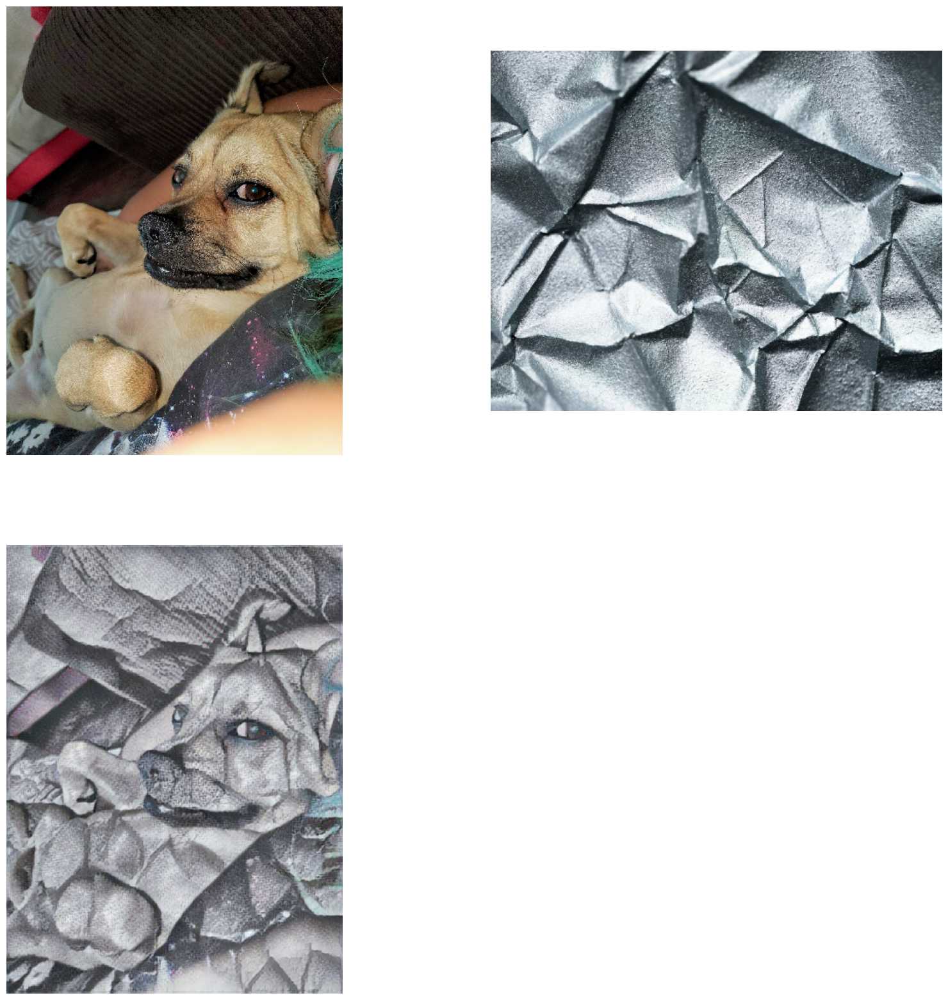

In [21]:
singleImage(source_img_paths[1], style_img_paths[1])

2023-02-18 21:53:29.948444: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


source path:  /Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_01.png
transfering 19 styles: 
. . . . . . . . . . . . . . . . . . .  DONE
images length:  19
plotting 19 total images with 4 columns in 5 rows


/var/folders/pv/3fqvv1_j3t7_hz1_s8rg4dhw0000gn/T/ipykernel_47007/2323646174.py:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(nrows, hop_size, i+1)


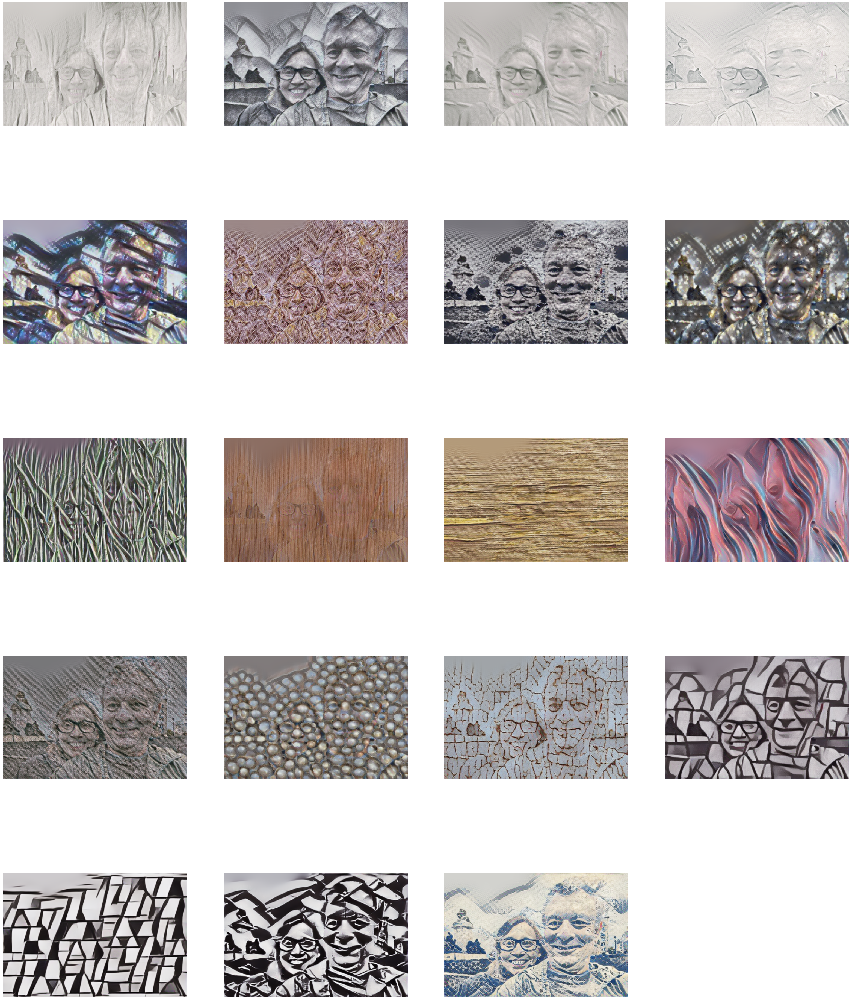

In [22]:
# styleize for selfie
transferAllStyles(source_img_paths[0], style_img_paths[:floor(len(style_img_paths)/2)])

source path:  /Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/pugs0.jpg
transfering 19 styles: 
. . . . . . . . . . . . . . . . . . .  DONE
images length:  19
plotting 19 total images with 4 columns in 5 rows


/var/folders/pv/3fqvv1_j3t7_hz1_s8rg4dhw0000gn/T/ipykernel_47007/2323646174.py:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(nrows, hop_size, i+1)


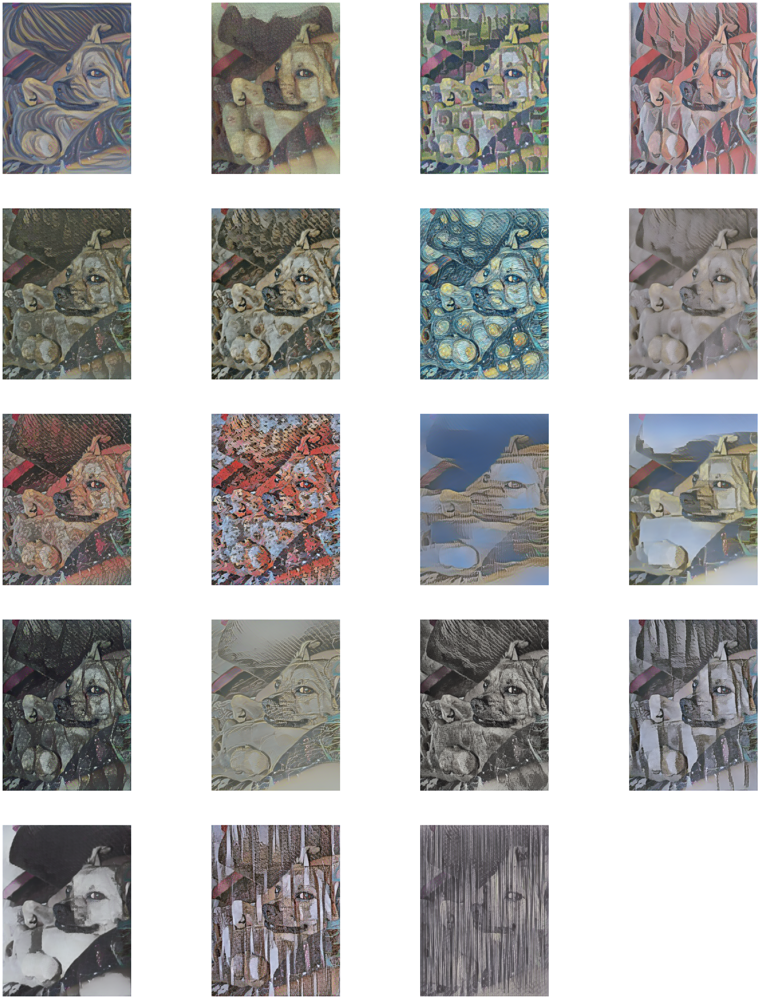

In [23]:
# styleize for NVS Tech Logo
transferAllStyles(source_img_paths[1], style_img_paths[floor(len(style_img_paths)/2):])

In [24]:
transferEverything()

2023-02-18 21:58:24.709339: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


source path:  /Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_01.png
transfering 38 styles: 
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .  DONE
images length:  38
plotting 38 total images with 5 columns in 8 rows


/var/folders/pv/3fqvv1_j3t7_hz1_s8rg4dhw0000gn/T/ipykernel_47007/2323646174.py:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(nrows, hop_size, i+1)


source path:  /Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/pugs0.jpg
transfering 38 styles: 
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .  DONE
images length:  38
plotting 38 total images with 5 columns in 8 rows


2023-02-18 22:15:28.922760: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


source path:  /Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_03.png
transfering 38 styles: 
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .  DONE
images length:  38
plotting 38 total images with 5 columns in 8 rows


2023-02-18 22:23:48.706020: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile


source path:  /Users/nathan/workspace/tensor_flow_projects/neural_style_transfer/source_images/parents_selfie_together_02.png
transfering 38 styles: 
. . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .  DONE
images length:  38
plotting 38 total images with 5 columns in 8 rows


## Define content and style representations

Use the intermediate layers of the model to get the *content* and *style* representations of the image. Starting from the network's input layer, the first few layer activations represent low-level features like edges and textures. As you step through the network, the final few layers represent higher-level features—object parts like *wheels* or *eyes*. In this case, you are using the VGG19 network architecture, a pretrained image classification network. These intermediate layers are necessary to define the representation of content and style from the images. For an input image, try to match the corresponding style and content target representations at these intermediate layers.


Load a [VGG19](https://keras.io/api/applications/vgg/#vgg19-function) and test run it on our image to ensure it's used correctly:

In [ ]:
source_path = source_img_paths[0]
style_path = style_img_paths[8]
source_image = load_img(source_path)
style_image = load_img(style_path)
outputs = []
outputs.extend(source_image)
outputs.extend(style_image)
x = tf.keras.applications.vgg19.preprocess_input(source_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

plot_images(outputs)

Now load a `VGG19` without the classification head, and list the layer names

In [ ]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
  print(layer.name)

# Choose intermediate layers from the network to represent the style and content of the image:
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

#### Intermediate layers for style and content

So why do these intermediate outputs within our pretrained image classification network allow us to define style and content representations?

At a high level, in order for a network to perform image classification (which this network has been trained to do), it must understand the image. This requires taking the raw image as input pixels and building an internal representation that converts the raw image pixels into a complex understanding of the features present within the image.

This is also a reason why convolutional neural networks are able to generalize well: they’re able to capture the invariances and defining features within classes (e.g. cats vs. dogs) that are agnostic to background noise and other nuisances. Thus, somewhere between where the raw image is fed into the model and the output classification label, the model serves as a complex feature extractor. By accessing intermediate layers of the model, you're able to describe the content and style of input images.

## Build and Create the model 

The networks in `tf.keras.applications` are designed so you can easily extract the intermediate layer values using the Keras functional API.

To define a model using the functional API, specify the inputs and outputs:

`model = Model(inputs, outputs)`

This following function builds a VGG19 model that returns a list of intermediate layer outputs:

In [ ]:
def vgg_layers(layer_names):
  """ Creates a VGG model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on ImageNet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False
  
  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model

# And to create the model:

style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
  print(name)
  print("  shape: ", output.numpy().shape)
  print("  min: ", output.numpy().min())
  print("  max: ", output.numpy().max())
  print("  mean: ", output.numpy().mean())
  print()

## Calculate style

The content of an image is represented by the values of the intermediate feature maps.

It turns out, the style of an image can be described by the means and correlations across the different feature maps. Calculate a Gram matrix that includes this information by taking the outer product of the feature vector with itself at each location, and averaging that outer product over all locations. This Gram matrix can be calculated for a particular layer as:

$$G^l_{cd} = \frac{\sum_{ij} F^l_{ijc}(x)F^l_{ijd}(x)}{IJ}$$

This can be implemented concisely using the `tf.linalg.einsum` function:

In [ ]:
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

# Build a model that returns the style and content tensors.
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg = vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}
    
# When called on an image, this model returns the gram matrix (style) of the `style_layers` and content of the `content_layers`:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(source_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())


## Run gradient descent

With this style and content extractor, you can now implement the style transfer algorithm. Do this by calculating the mean square error for your image's output relative to each target, then take the weighted sum of these losses.

Set your style and content target values:

In [ ]:
style_targets = extractor(style_image)['style']
content_targets = extractor(source_image)['content']
# Define a `tf.Variable` to contain the image to optimize. 
# To make this quick, initialize it with the content image 
# (the `tf.Variable` must be the same shape as the content image):
image = tf.Variable(source_image)
# Since this is a float image, define a function to keep the pixel values between 0 and 1:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

# Create an optimizer. The paper recommends LBFGS, but Adam works okay, too: 
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
# To optimize this, use a weighted combination of the two losses to get the total loss:
style_weight=1e-2
content_weight=1e4

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

# tf.GradientTape updates the images
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))


Now run a few steps to test:

In [ ]:
outputs = []
train_step(image)
outputs.extend(image)
train_step(image)
outputs.extend(image)
train_step(image)
outputs.extend(image)
plot_images(outputs)

Since it's working, perform a longer optimization:

In [ ]:
outputs = []

# was originally 10 and 100
epochs = 5
steps_per_epoch = 10

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  img = tensor_to_image(image)
  display.display(img)
  outputs.extend(image)
  print("Train step: {}".format(step))
  
save_images(outputs)
plot_images(outputs)


## Total variation loss

One downside to this basic implementation is that it produces a lot of high frequency artifacts. Decrease these using an explicit regularization term on the high frequency components of the image. In style transfer, this is often called the *total variation loss*:

In [ ]:
def high_pass_x_y(image):
  x_var = image[:, :, 1:, :] - image[:, :, :-1, :]
  y_var = image[:, 1:, :, :] - image[:, :-1, :, :]

  return x_var, y_var

x_deltas, y_deltas = high_pass_x_y(source_image)

plt.figure(figsize=(14, 10))
plt.subplot(2, 2, 1)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Original")

plt.subplot(2, 2, 2)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Original")

x_deltas, y_deltas = high_pass_x_y(image)

plt.subplot(2, 2, 3)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Styled")

plt.subplot(2, 2, 4)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Styled")

This shows how the high frequency components have increased.

Also, this high frequency component is basically an edge-detector. You can get similar output from the Sobel edge detector, for example:

In [ ]:
plt.figure(figsize=(14, 10))

sobel = tf.image.sobel_edges(source_image)
plt.subplot(1, 2, 1)
imshow(clip_0_1(sobel[..., 0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1, 2, 2)
imshow(clip_0_1(sobel[..., 1]/4+0.5), "Vertical Sobel-edges")

The regularization loss associated with this is the sum of the squares of the values:

In [ ]:
def total_variation_loss(image):
  x_deltas, y_deltas = high_pass_x_y(image)
  return tf.reduce_sum(tf.abs(x_deltas)) + tf.reduce_sum(tf.abs(y_deltas))

In [ ]:
total_variation_loss(image).numpy()

That demonstrated what it does. But there's no need to implement it yourself, TensorFlow includes a standard implementation:

In [ ]:
tf.image.total_variation(image).numpy()

## Re-run the optimization

Choose a weight for the `total_variation_loss`:

In [ ]:
total_variation_weight=30

Now include it in the `train_step` function:

In [ ]:
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)
    loss += total_variation_weight*tf.image.total_variation(image)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

Reinitialize the image-variable and the optimizer:

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
image = tf.Variable(source_image)

And run the optimization:

In [ ]:
import time
start = time.time()

epochs = 5
steps_per_epoch = 10

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))
save_images(image)
plot_images(image)